In [1]:
!pip install opencv-python 
!pip install mediapipe
!pip install scikit-learn
!pip install pandas
!pip install matplotlib

Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import cv2
import mediapipe as mp
import numpy as np
import math
import pandas as pd
import os
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [3]:
mp_hands = mp.solutions.hands
hands = mp_hands.Hands()

In [4]:
def MiddleFingerDetector(landmarks):
    middle_finger_tip = landmarks[mp_hands.HandLandmark.MIDDLE_FINGER_TIP.value]
    middle_finger_pip = landmarks[mp_hands.HandLandmark.MIDDLE_FINGER_PIP.value]
    middle_finger_mcp = landmarks[mp_hands.HandLandmark.MIDDLE_FINGER_MCP.value]
    middle_diff = math.pow(middle_finger_tip[1] - middle_finger_mcp[1], 2) + math.pow(middle_finger_tip[0] - middle_finger_mcp[0], 2)
    middle_diff /= 2

    index_finger_tip = landmarks[mp_hands.HandLandmark.INDEX_FINGER_TIP.value]
    index_finger_pip = landmarks[mp_hands.HandLandmark.INDEX_FINGER_PIP.value]
    index_finger_mcp = landmarks[mp_hands.HandLandmark.INDEX_FINGER_MCP.value]
    index_diff = math.pow(index_finger_tip[1] - index_finger_mcp[1], 2) + math.pow(index_finger_tip[0] - index_finger_mcp[0], 2)


    ring_finger_tip = landmarks[mp_hands.HandLandmark.RING_FINGER_TIP.value]
    ring_finger_pip = landmarks[mp_hands.HandLandmark.RING_FINGER_PIP.value]
    ring_finger_mcp = landmarks[mp_hands.HandLandmark.RING_FINGER_MCP.value]
    ring_diff = math.pow(ring_finger_tip[1] - ring_finger_mcp[1], 2) + math.pow(ring_finger_tip[0] - ring_finger_mcp[0], 2)

    pinky_finger_tip = landmarks[mp_hands.HandLandmark.PINKY_TIP.value]
    pinky_finger_pip = landmarks[mp_hands.HandLandmark.PINKY_PIP.value]
    pinky_finger_mcp = landmarks[mp_hands.HandLandmark.PINKY_MCP.value]
    pinky_diff = math.pow(pinky_finger_tip[1] - pinky_finger_mcp[1], 2) + math.pow(pinky_finger_tip[0] - pinky_finger_mcp[0], 2)

    middle_finger_is_raised = False
    if middle_diff > index_diff and middle_diff > ring_diff and middle_diff > pinky_diff:
        middle_finger_is_raised = True

    return middle_finger_is_raised

In [5]:
def prediction_test(csv_path, directory_img): 
    df = pd.read_csv(csv_path)
    y_true = df.label.to_list()
    label = df.name.to_list()
    y_pred = []

    for name in label:
        img_path = directory_img + name
        frame = cv2.imread(img_path)
        rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        results = hands.process(rgb_frame)

        pred = False

        if results.multi_hand_landmarks:
            insulting_gesture = []
            for hand_landmarks in results.multi_hand_landmarks:
                landmarks_np = np.array([(lm.x, lm.y) for lm in hand_landmarks.landmark], dtype=np.float32)

                x, y = np.min(landmarks_np, axis=0)
                w, h = np.max(landmarks_np, axis=0) - (x, y)

                scale_factor = 1.5
                x -= w * (scale_factor - 1) / 2
                y -= h * (scale_factor - 1) / 2
                w *= scale_factor
                h *= scale_factor

                detected = MiddleFingerDetector(landmarks_np)
                insulting_gesture.append(detected)
                
            for e in insulting_gesture:
                pred = pred or e
            
        if pred:
            y_pred.append(1)
        else:
            y_pred.append(0)
    return label, y_true, y_pred


In [6]:
label_hard, y_true_hard, y_pred_hard = prediction_test("./dataset/output_hard.csv", "./dataset/test_set_hard_case/")

In [7]:
label_normal, y_true_normal, y_pred_normal = prediction_test("./dataset/output_normal.csv", "./dataset/test_set_normal_case/")

In [8]:
label_all, y_true_all, y_pred_all = prediction_test("./dataset/output.csv", "./dataset/test_set/")

In [9]:
def compute_metrics(y_true, y_pred):
    accuracy = accuracy_score(y_true, y_pred)
    print(f'Accuracy: {accuracy}')

    # Confusion Matrix
    conf_matrix = confusion_matrix(y_true, y_pred)
    print(f'Confusion Matrix:\n{conf_matrix}')

    # Classification Report
    class_report = classification_report(y_true, y_pred)
    print(f'Classification Report:\n{class_report}')

In [10]:
compute_metrics(y_true_hard, y_pred_hard)

Accuracy: 0.79
Confusion Matrix:
[[50  0]
 [21 29]]
Classification Report:
              precision    recall  f1-score   support

           0       0.70      1.00      0.83        50
           1       1.00      0.58      0.73        50

    accuracy                           0.79       100
   macro avg       0.85      0.79      0.78       100
weighted avg       0.85      0.79      0.78       100



In [11]:
compute_metrics(y_true_normal, y_pred_normal)

Accuracy: 0.855
Confusion Matrix:
[[100   0]
 [ 29  71]]
Classification Report:
              precision    recall  f1-score   support

           0       0.78      1.00      0.87       100
           1       1.00      0.71      0.83       100

    accuracy                           0.85       200
   macro avg       0.89      0.85      0.85       200
weighted avg       0.89      0.85      0.85       200



In [13]:
compute_metrics(y_true_all, y_pred_all)

Accuracy: 0.8333333333333334
Confusion Matrix:
[[150   0]
 [ 50 100]]
Classification Report:
              precision    recall  f1-score   support

           0       0.75      1.00      0.86       150
           1       1.00      0.67      0.80       150

    accuracy                           0.83       300
   macro avg       0.88      0.83      0.83       300
weighted avg       0.88      0.83      0.83       300



In [22]:
false_hard = []
for i in range(len(y_pred_hard)):
    if(y_pred_hard[i] == 0 and y_true_hard[i] == 1):
        false_hard.append(label_hard[i])

false_normal = []
for i in range(len(y_pred_normal)):
    if(y_pred_normal[i] == 0):
        false_normal.append(label_normal[i])

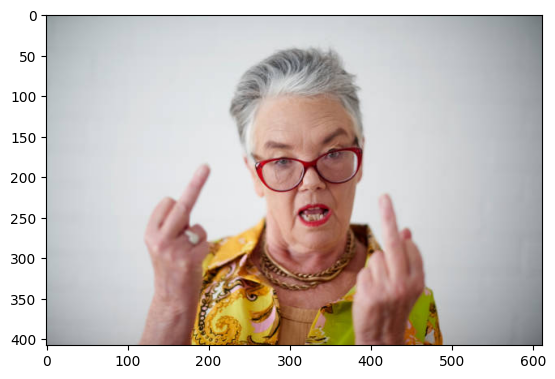

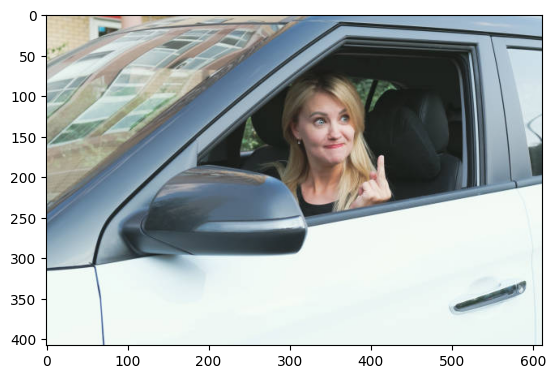

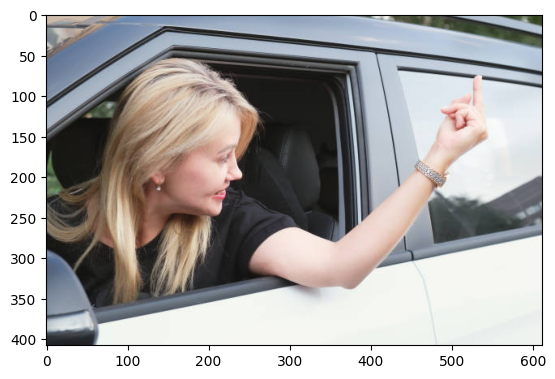

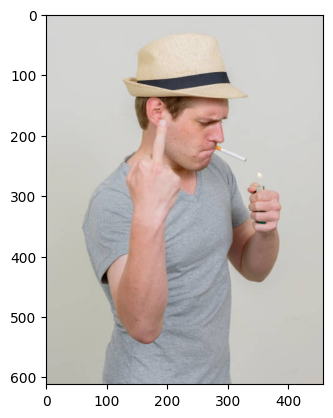

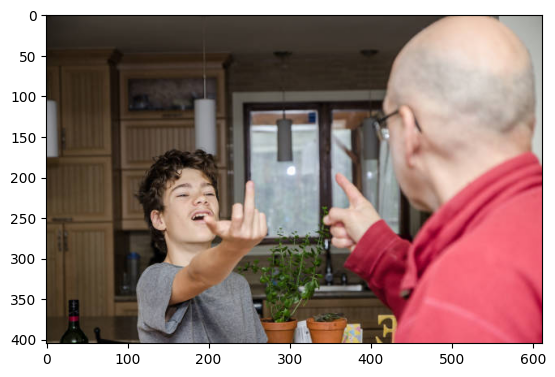

...

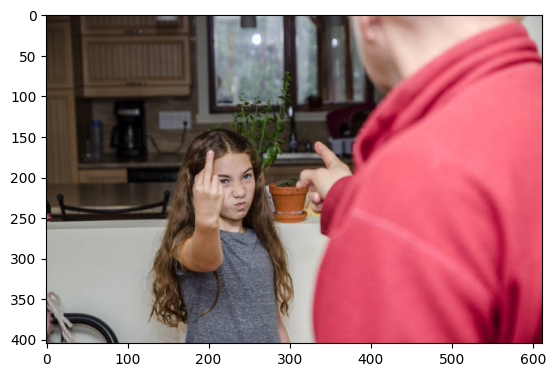

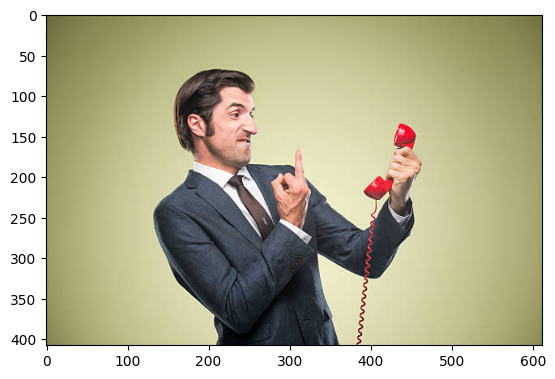

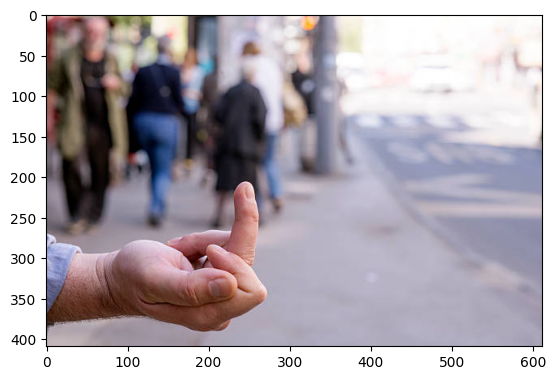

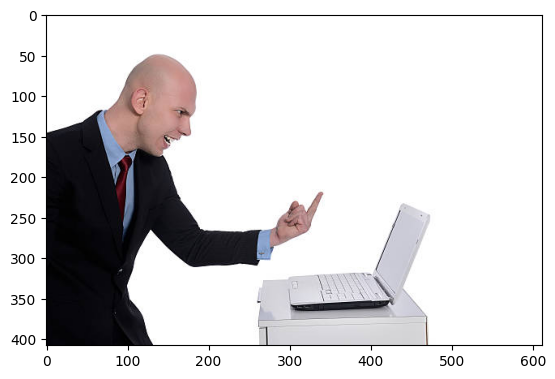

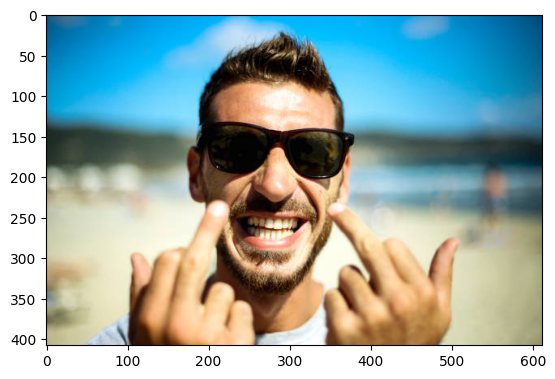

In [25]:
for img_pth in false_hard:
    img = cv2.imread("./dataset/test_set_hard_case/" + img_pth)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    plt.show()

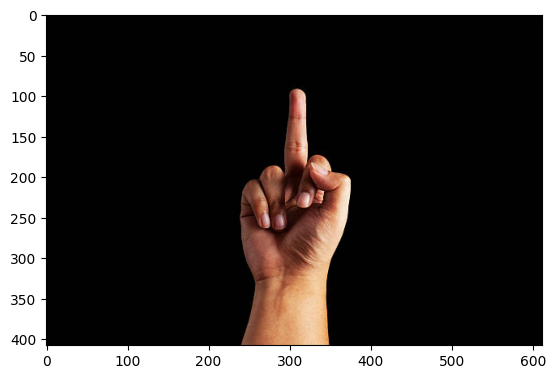

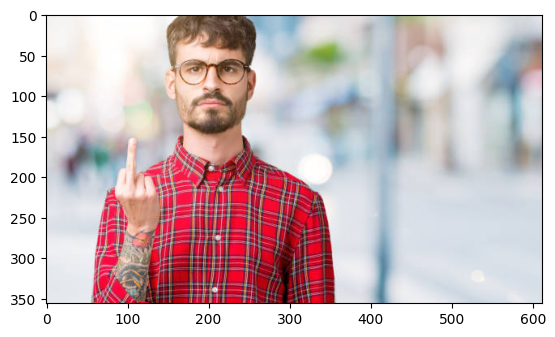

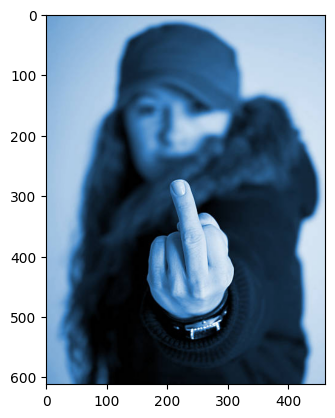

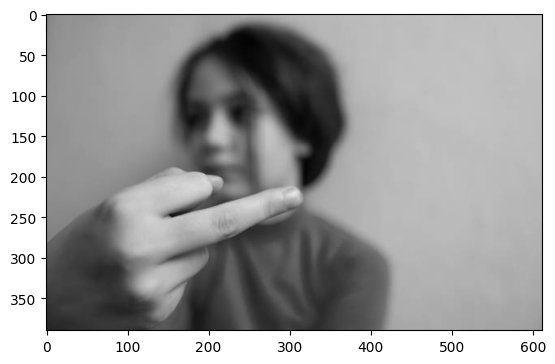

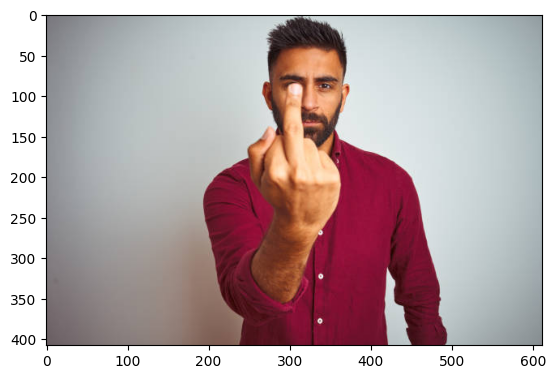

...

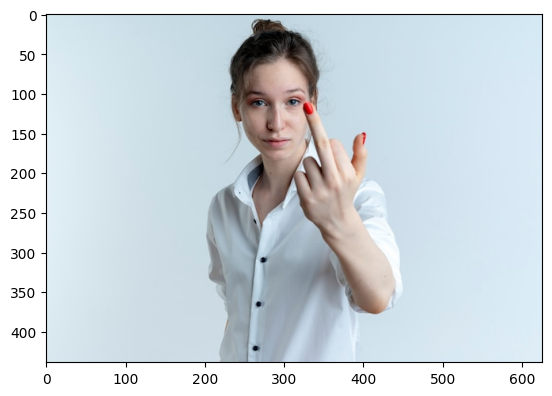

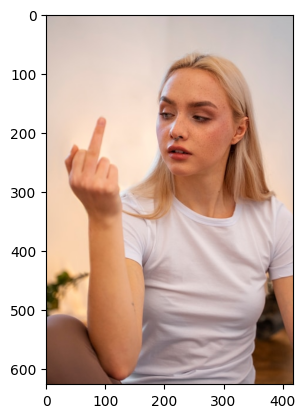

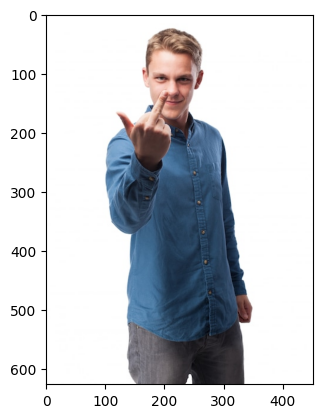

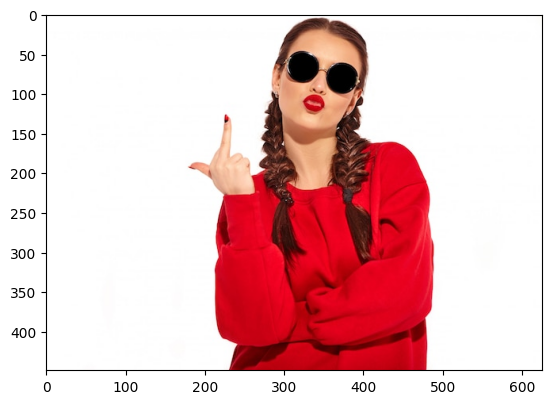

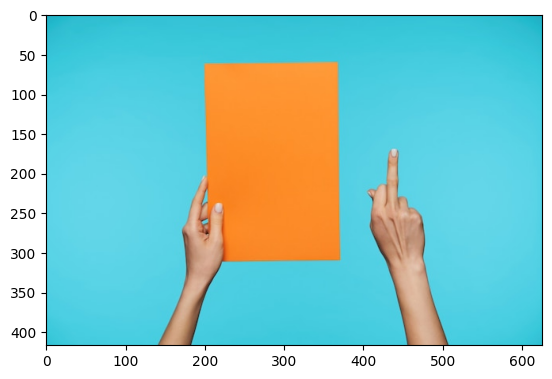

In [15]:
for img_pth in false_normal:
    img = cv2.imread("./dataset/normal_case/" + img_pth)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    plt.show()

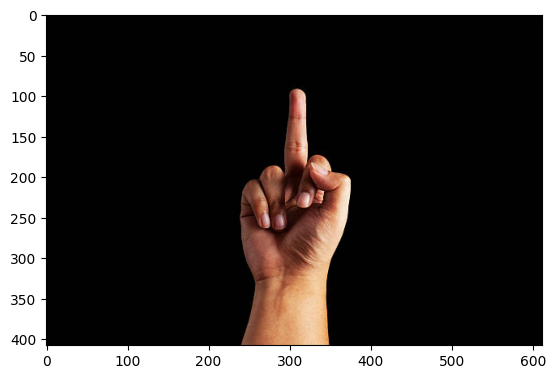

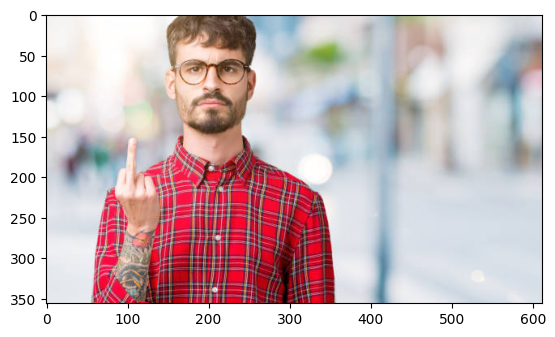

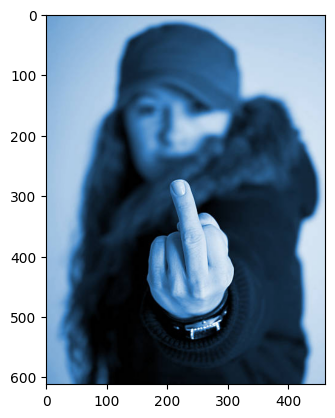

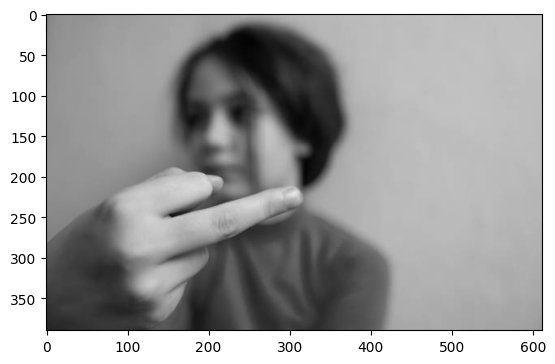

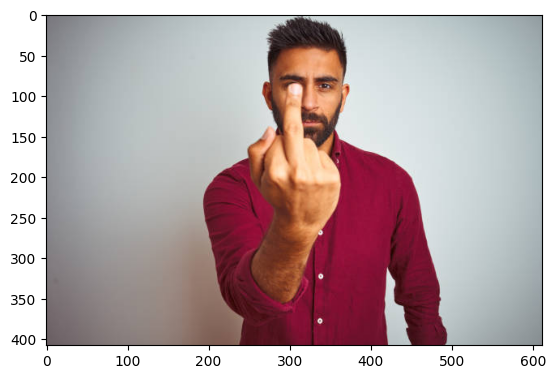

...

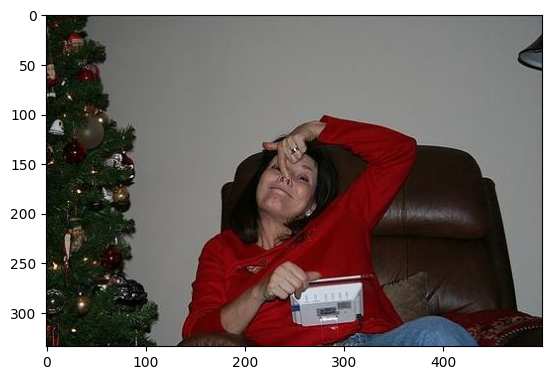

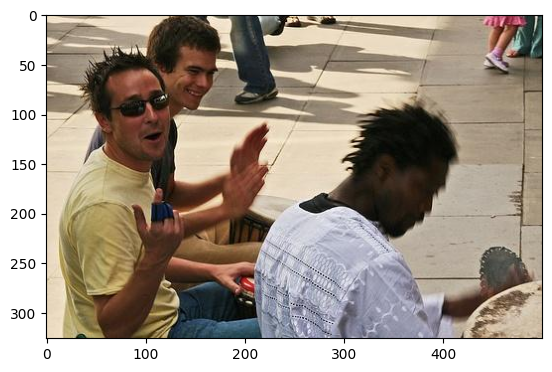

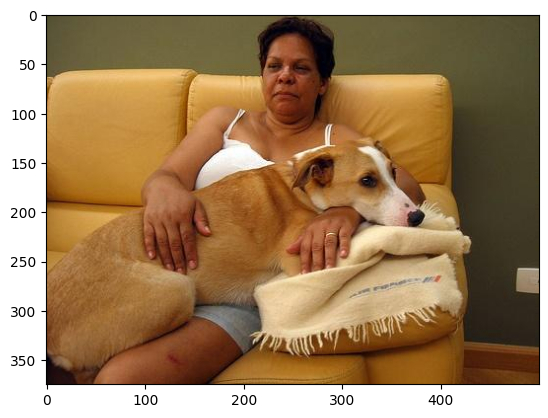

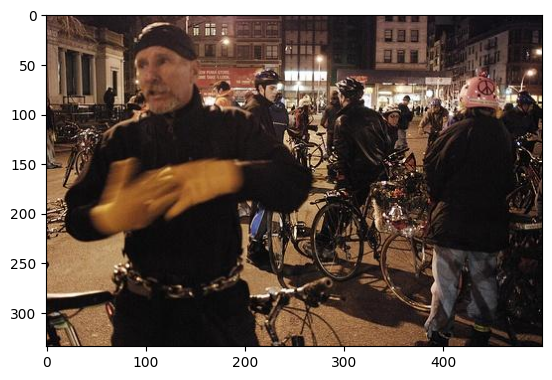

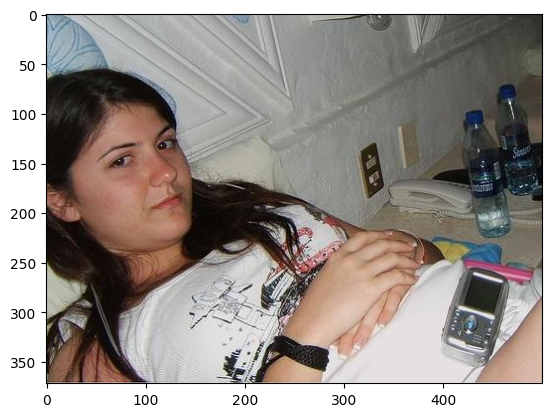

In [26]:
for img_pth in false_normal:
    img = cv2.imread("./dataset/test_set_normal_case/" + img_pth)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    plt.show()